In [1]:
import numpy as np
import matplotlib.pyplot as plt
import iceMACS
import datetime
import os 
import xarray as xr

%load_ext autoreload
%autoreload 2

/usr/lib/python3/dist-packages/distributed/config.py:20: YAMLLoadWarning: calling yaml.load() without Loader=... is deprecated, as the default Loader is unsafe. Please read https://msg.pyyaml.org/load for full details.
  defaults = yaml.load(f)


Load bahamas data...
Load and calibrate SWIR data...
{'units': 'degree', 'long_name': 'central across track angle of given pixel'}
Load bahamas data...


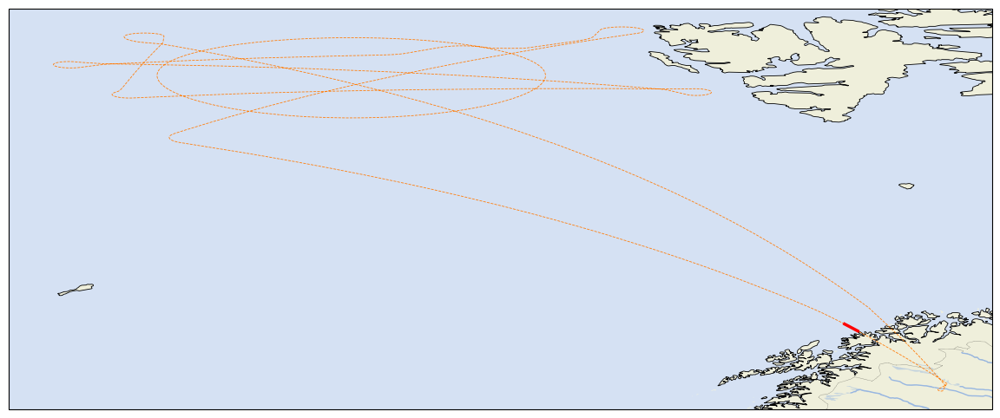

In [2]:
start_time = datetime.datetime(2022, 4, 8, 4, 47, 0)
end_time = datetime.datetime(2022, 4, 8, 4, 49, 10)

nas_scene, swir_scene_raw, vnir_scene_raw = iceMACS.load_AC3_scene(start_time, end_time, vnir=False)
iceMACS.map_AC3_scene(start_time, end_time)

In [3]:
iceMACS.save_as_netcdf(nas_scene, "data/nas_scene.nc")

In [4]:
swir_scene = swir_scene_raw.sel(wavelength=[1250, 1550, 1600, 1700], method='nearest').load()

In [5]:
interp = iceMACS.PixelInterpolator(swir_scene, window=2)

In [6]:
interp.add_cutoffs([2, 2, 1, 2])

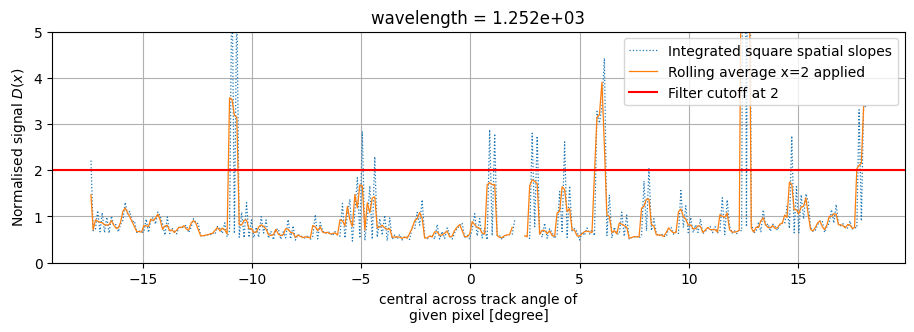

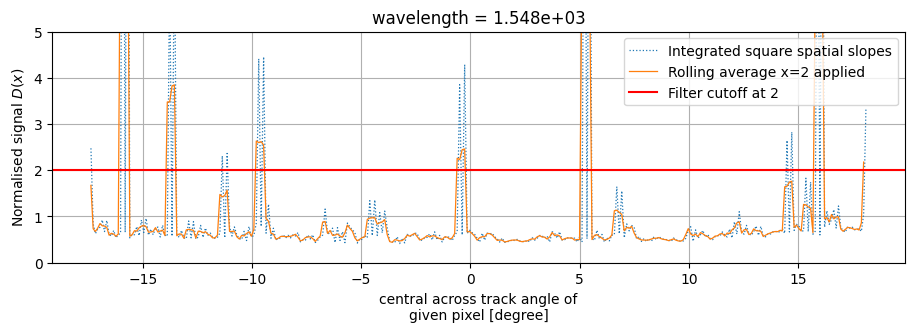

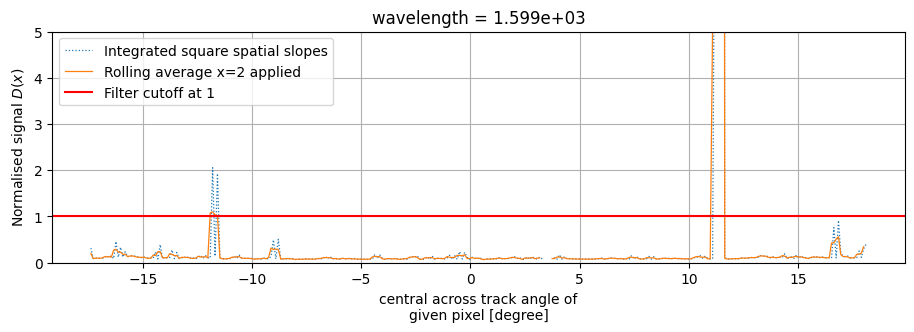

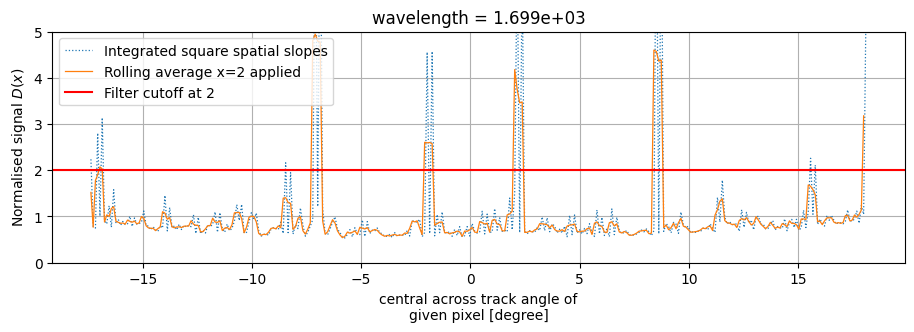

In [7]:
interp.show_signals()

In [8]:
swir_scene['radiance'] = interp.filtered_radiance(remove=True)

In [9]:
iceMACS.save_as_netcdf(swir_scene, "data/RF15_swir_scene.nc")

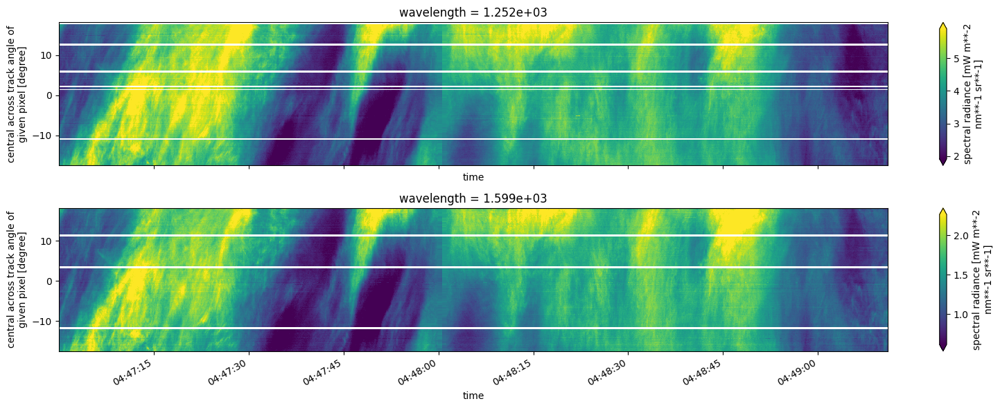

In [10]:
fig, ax = plt.subplots(nrows=2, figsize=(16,6), sharex=True)
swir_scene.radiance.sel(wavelength=1250, method='nearest').plot(x='time', robust=True, ax=ax[0])
swir_scene.radiance.sel(wavelength=1600, method='nearest').plot(x='time', robust=True, ax=ax[1])
plt.tight_layout()
#plt.savefig('scene.png')

In [11]:
# from macstrace.Halo import Halo
# halo = Halo.from_datasets('../../mounttrees/ac3_mounttree.yaml', nas_scene, [swir_scene])#[vnir_scene, swir_scene])
# view_angles = halo.get_abs_view_angles('swir').isel(wavelength=0)
# iceMACS.save_as_netcdf(view_angles, 'data/view_angles.nc')

# solar_positions=iceMACS.get_solar_positions(nas_scene)
# iceMACS.save_as_netcdf(solar_positions, 'data/solar_positions.nc')

In [12]:
solar_positions = iceMACS.read_LUT('data/solar_positions.nc')
view_angles = iceMACS.read_LUT('data/view_angles.nc')

In [13]:
from iceMACS.tools import SceneInterpreter
scene = SceneInterpreter(swir_scene, view_angles, solar_positions)

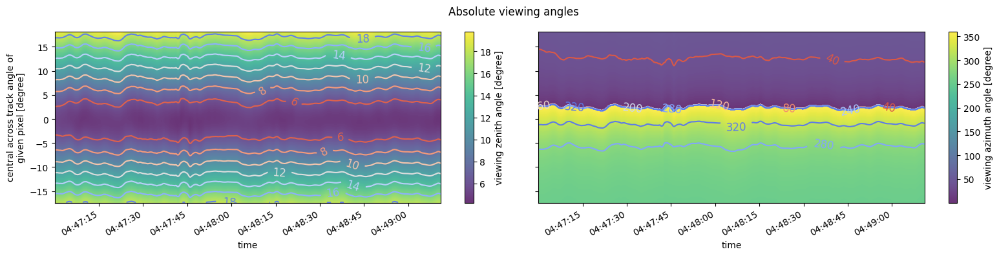

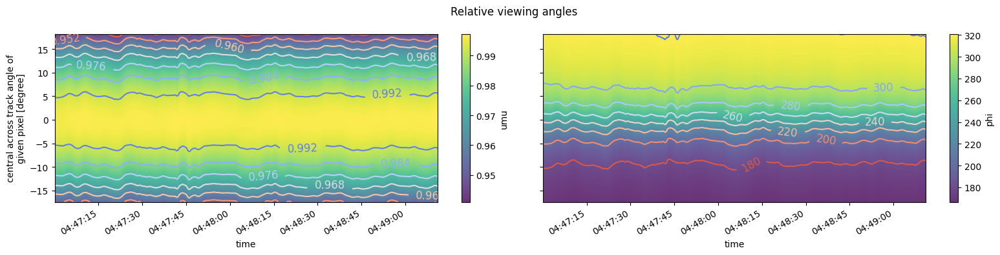

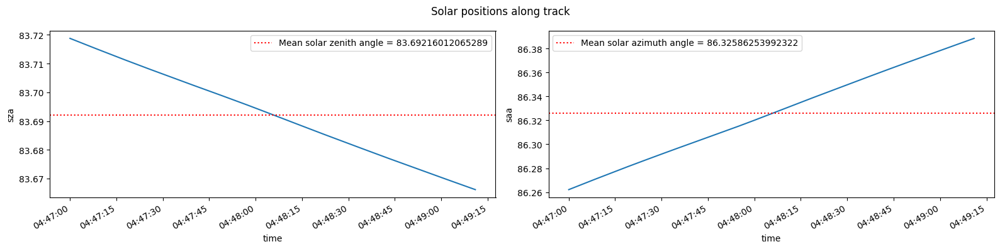

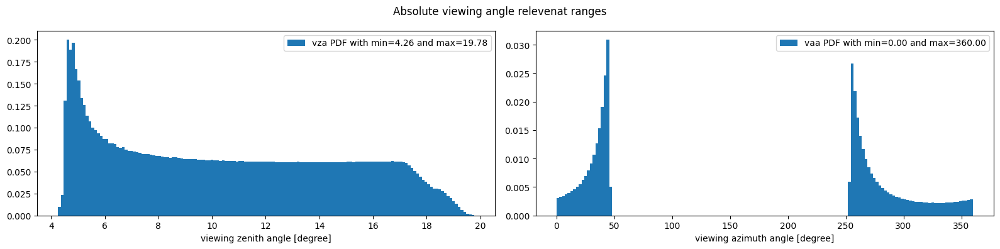

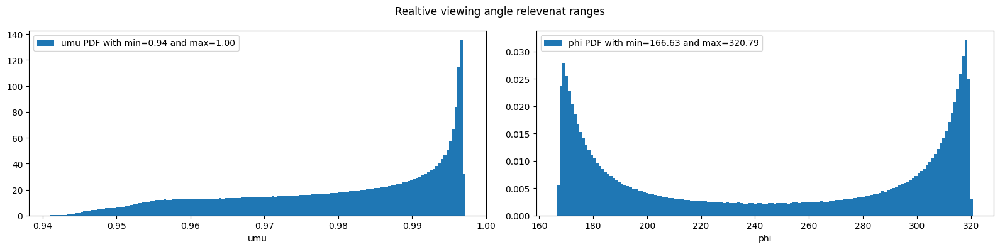

(array(83.69216012),
 array(86.32586254),
 array(0.94097456),
 array(0.99724123),
 array(166.62504563),
 array(320.78539232))

In [14]:
scene.overview()

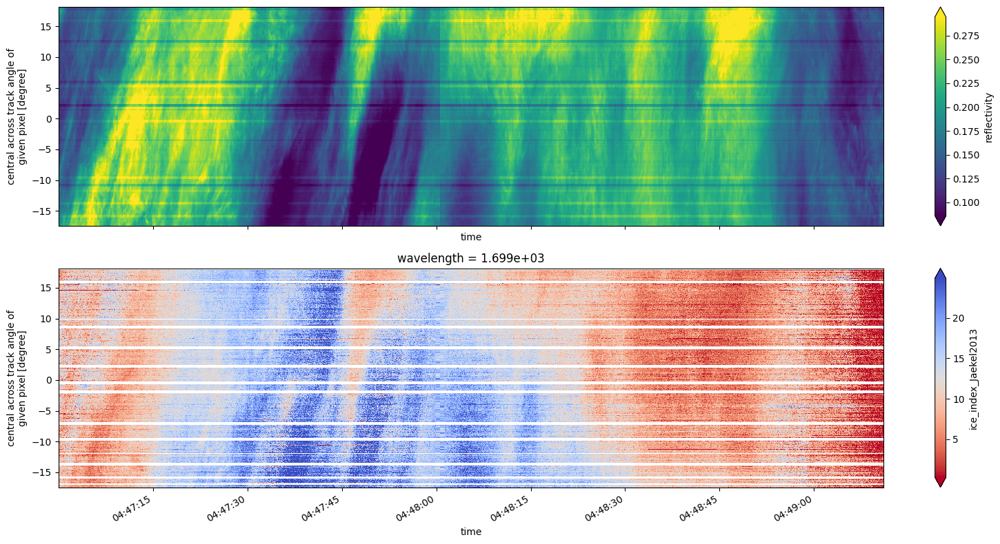

In [15]:
fig, ax = plt.subplots(nrows=2, figsize=(16,8), sharex=True)
scene.reflectivity().mean(dim='wavelength').plot(x='time', robust=True, ax=ax[0])
scene.ice_index_Jaekel2013().plot(x='time', robust=True, ax=ax[1], cmap='coolwarm_r')
plt.tight_layout()
#plt.savefig('scene.png')

## Bispectral retrieval

In [18]:
directory_path = "LUTs/disort/"
all_items = os.listdir(directory_path)

inverted_ghm_LUT = iceMACS.read_LUT('LUTs/disort/RF15_ghm_LUT_inverted.nc')

inverted_rough_LUTs = [directory_path+item
                       for item
                       in all_items if (item.startswith("RF15") and item.endswith("rough_LUT_inverted.nc"))]

rough_LUTs = [directory_path+item
              for item
              in all_items if (item.startswith("RF15") and item.endswith("rough_LUT.nc"))]

inverted_smooth_LUTs = [directory_path+item
                       for item
                       in all_items if (item.startswith("RF15") and item.endswith("smooth_LUT_inverted.nc"))]

rough_LUTs = [directory_path+item
              for item
              in all_items if (item.startswith("RF15") and item.endswith("smooth_LUT.nc"))]

In [20]:
from iceMACS.tools import BSRLookupTable
ghm_LUT = BSRLookupTable.from_path('LUTs/disort/RF15_ghm_LUT.nc')

cloud_property_list_rough = [scene.cloud_properties_fast_BSR(inverted_ghm_LUT, 1250, 1600, 
                                                       ghm_LUT.Rone_name, ghm_LUT.Rtwo_name,
                                                       umu_bins=30, phi_bins=100)]

for path in inverted_rough_LUTs:
    inverted = iceMACS.read_LUT(path)
    cloud_properties = scene.cloud_properties_fast_BSR(inverted, 1250, 1600, 
                                                       ghm_LUT.Rone_name, ghm_LUT.Rtwo_name,
                                                       umu_bins=30, phi_bins=100)
    cloud_property_list_rough.append(cloud_properties)

  8%|█████████▊                                                                                                                 | 8/100 [00:16<03:11,  2.08s/it]/home/d/Dennys.Erdtmann/.local/lib/python3.8/site-packages/xarray/core/missing.py:564: RuntimeWarning: All-NaN slice encountered
  minval = np.nanmin(new_x.values)
/home/d/Dennys.Erdtmann/.local/lib/python3.8/site-packages/xarray/core/missing.py:565: RuntimeWarning: All-NaN slice encountered
  maxval = np.nanmax(new_x.values)
 66%|████████████████████████████████████████████████████████████████████████████████▌                                         | 66/100 [02:16<01:14,  2.18s/it]/home/d/Dennys.Erdtmann/.local/lib/python3.8/site-packages/xarray/core/missing.py:564: RuntimeWarning: All-NaN slice encountered
  minval = np.nanmin(new_x.values)
/home/d/Dennys.Erdtmann/.local/lib/python3.8/site-packages/xarray/core/missing.py:565: RuntimeWarning: All-NaN slice encountered
  maxval = np.nanmax(new_x.values)
 71%|███████████████████

  8%|█████████▊                                                                                                                 | 8/100 [00:17<03:25,  2.23s/it]/home/d/Dennys.Erdtmann/.local/lib/python3.8/site-packages/xarray/core/missing.py:564: RuntimeWarning: All-NaN slice encountered
  minval = np.nanmin(new_x.values)
/home/d/Dennys.Erdtmann/.local/lib/python3.8/site-packages/xarray/core/missing.py:565: RuntimeWarning: All-NaN slice encountered
  maxval = np.nanmax(new_x.values)
 66%|████████████████████████████████████████████████████████████████████████████████▌                                         | 66/100 [02:26<01:15,  2.23s/it]/home/d/Dennys.Erdtmann/.local/lib/python3.8/site-packages/xarray/core/missing.py:564: RuntimeWarning: All-NaN slice encountered
  minval = np.nanmin(new_x.values)
/home/d/Dennys.Erdtmann/.local/lib/python3.8/site-packages/xarray/core/missing.py:565: RuntimeWarning: All-NaN slice encountered
  maxval = np.nanmax(new_x.values)
 71%|███████████████████

  8%|█████████▊                                                                                                                 | 8/100 [00:17<03:11,  2.08s/it]/home/d/Dennys.Erdtmann/.local/lib/python3.8/site-packages/xarray/core/missing.py:564: RuntimeWarning: All-NaN slice encountered
  minval = np.nanmin(new_x.values)
/home/d/Dennys.Erdtmann/.local/lib/python3.8/site-packages/xarray/core/missing.py:565: RuntimeWarning: All-NaN slice encountered
  maxval = np.nanmax(new_x.values)
 66%|████████████████████████████████████████████████████████████████████████████████▌                                         | 66/100 [02:18<01:14,  2.21s/it]/home/d/Dennys.Erdtmann/.local/lib/python3.8/site-packages/xarray/core/missing.py:564: RuntimeWarning: All-NaN slice encountered
  minval = np.nanmin(new_x.values)
/home/d/Dennys.Erdtmann/.local/lib/python3.8/site-packages/xarray/core/missing.py:565: RuntimeWarning: All-NaN slice encountered
  maxval = np.nanmax(new_x.values)
 71%|███████████████████

In [32]:
cloud_property_list_smooth = []

for path in inverted_smooth_LUTs:
    inverted = iceMACS.read_LUT(path)
    cloud_properties = scene.cloud_properties_fast_BSR(inverted, 1250, 1600, 
                                                       ghm_LUT.Rone_name, ghm_LUT.Rtwo_name,
                                                       umu_bins=30, phi_bins=100)
    cloud_property_list_smooth.append(cloud_properties)

  8%|█████████▊                                                                                                                 | 8/100 [00:18<03:32,  2.31s/it]/home/d/Dennys.Erdtmann/.local/lib/python3.8/site-packages/xarray/core/missing.py:564: RuntimeWarning: All-NaN slice encountered
  minval = np.nanmin(new_x.values)
/home/d/Dennys.Erdtmann/.local/lib/python3.8/site-packages/xarray/core/missing.py:565: RuntimeWarning: All-NaN slice encountered
  maxval = np.nanmax(new_x.values)
 66%|████████████████████████████████████████████████████████████████████████████████▌                                         | 66/100 [02:29<01:16,  2.24s/it]/home/d/Dennys.Erdtmann/.local/lib/python3.8/site-packages/xarray/core/missing.py:564: RuntimeWarning: All-NaN slice encountered
  minval = np.nanmin(new_x.values)
/home/d/Dennys.Erdtmann/.local/lib/python3.8/site-packages/xarray/core/missing.py:565: RuntimeWarning: All-NaN slice encountered
  maxval = np.nanmax(new_x.values)
 71%|███████████████████

  8%|█████████▊                                                                                                                 | 8/100 [00:18<03:33,  2.32s/it]/home/d/Dennys.Erdtmann/.local/lib/python3.8/site-packages/xarray/core/missing.py:564: RuntimeWarning: All-NaN slice encountered
  minval = np.nanmin(new_x.values)
/home/d/Dennys.Erdtmann/.local/lib/python3.8/site-packages/xarray/core/missing.py:565: RuntimeWarning: All-NaN slice encountered
  maxval = np.nanmax(new_x.values)
 66%|████████████████████████████████████████████████████████████████████████████████▌                                         | 66/100 [02:27<01:15,  2.21s/it]/home/d/Dennys.Erdtmann/.local/lib/python3.8/site-packages/xarray/core/missing.py:564: RuntimeWarning: All-NaN slice encountered
  minval = np.nanmin(new_x.values)
/home/d/Dennys.Erdtmann/.local/lib/python3.8/site-packages/xarray/core/missing.py:565: RuntimeWarning: All-NaN slice encountered
  maxval = np.nanmax(new_x.values)
 71%|███████████████████

  8%|█████████▊                                                                                                                 | 8/100 [00:19<03:42,  2.42s/it]/home/d/Dennys.Erdtmann/.local/lib/python3.8/site-packages/xarray/core/missing.py:564: RuntimeWarning: All-NaN slice encountered
  minval = np.nanmin(new_x.values)
/home/d/Dennys.Erdtmann/.local/lib/python3.8/site-packages/xarray/core/missing.py:565: RuntimeWarning: All-NaN slice encountered
  maxval = np.nanmax(new_x.values)
 66%|████████████████████████████████████████████████████████████████████████████████▌                                         | 66/100 [02:36<01:21,  2.40s/it]/home/d/Dennys.Erdtmann/.local/lib/python3.8/site-packages/xarray/core/missing.py:564: RuntimeWarning: All-NaN slice encountered
  minval = np.nanmin(new_x.values)
/home/d/Dennys.Erdtmann/.local/lib/python3.8/site-packages/xarray/core/missing.py:565: RuntimeWarning: All-NaN slice encountered
  maxval = np.nanmax(new_x.values)
 71%|███████████████████

In [35]:
#iceMACS.save_as_netcdf(xr.merge(cloud_property_list_rough), "data/RF15_merged_cloud_properties_rough.nc")
#iceMACS.save_as_netcdf(xr.merge(cloud_property_list_smooth), "data/RF15_merged_cloud_properties_smooth.nc")

In [36]:
merged_cloud_properties_rough=iceMACS.read_LUT("data/RF15_merged_cloud_properties_rough.nc")
merged_cloud_properties_smooth=iceMACS.read_LUT("data/RF15_merged_cloud_properties_smooth.nc")

In [81]:
name_dict = {"hollow_bullet_rosette":"HBR", 
             "column_8elements":"8-col.", 
             "droxtal":"drox.", 
             "ghm":"GHM", 
             "plate":"plate", 
             "plate_10elements":"10-plate", 
             "plate_5elements":"5-plate", 
             "solid_bullet_rosette":"SBR",
             "solid_column":"SC",
             "hollow_column":"HC"}

name_dict_rough = {"hollow_bullet_rosette":"HBR_r", 
             "column_8elements":"8-col_r", 
             "droxtal":"drox_r", 
             "ghm":"GHM", 
             "plate":"plate_r", 
             "plate_10elements":"10-plate_r", 
             "plate_5elements":"5-plate_r", 
             "solid_bullet_rosette":"SBR_r",
             "solid_column":"SC_r",
             "hollow_column":"HC_r"}

name_dict_smooth = {"hollow_bullet_rosette":"HBR_s", 
             "column_8elements":"8-col_s", 
             "droxtal":"drox_s", 
             "ghm":"GHM", 
             "plate":"plate_s", 
             "plate_10elements":"10-plate_s", 
             "plate_5elements":"5-plate_s", 
             "solid_bullet_rosette":"SBR_s",
             "solid_column":"SC_s",
             "hollow_column":"HC_s"}

single_habits = ["solid_column", "hollow_column", "plate", "droxtal"]
aggregate_habits = ["column_8elements", "plate_5elements", "plate_10elements"]
bullet_rosette_habits = ["solid_bullet_rosette", "hollow_bullet_rosette"]

plate_habits = ["plate", "plate_5elements", "plate_10elements"]
column_habits = ["solid_column", "hollow_column", "column_8elements"]
bullet_rosette_and_droxtal_habits = ["solid_bullet_rosette", "hollow_bullet_rosette", "droxtal"]

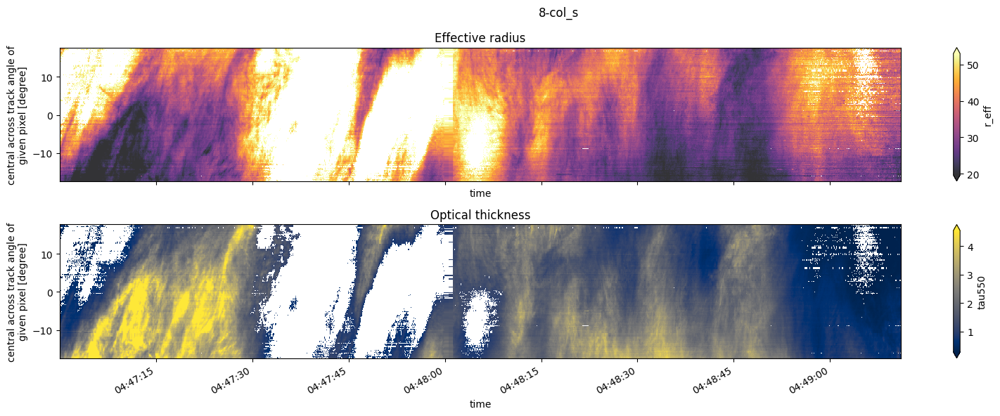

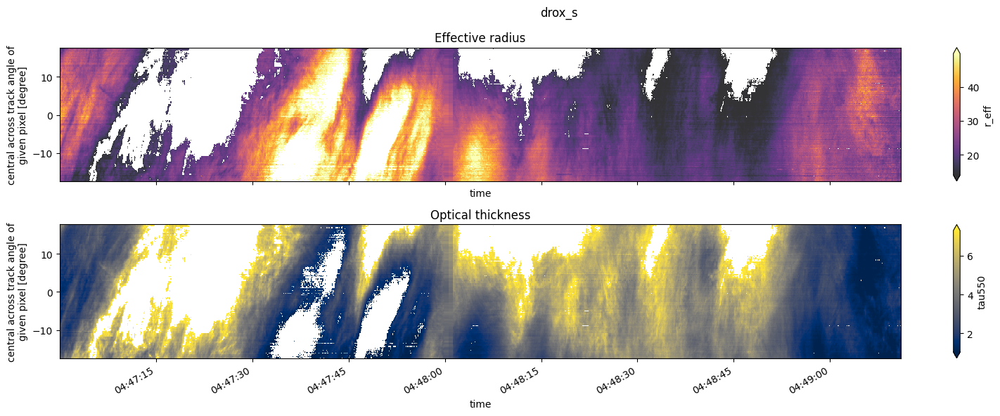

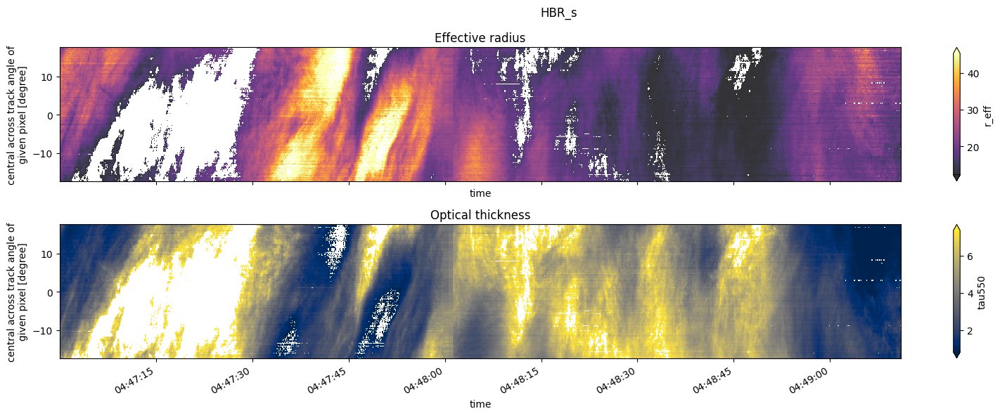

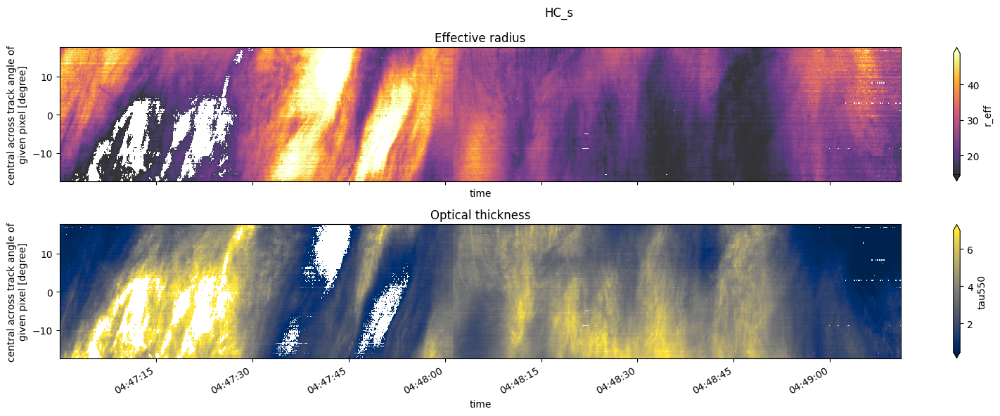

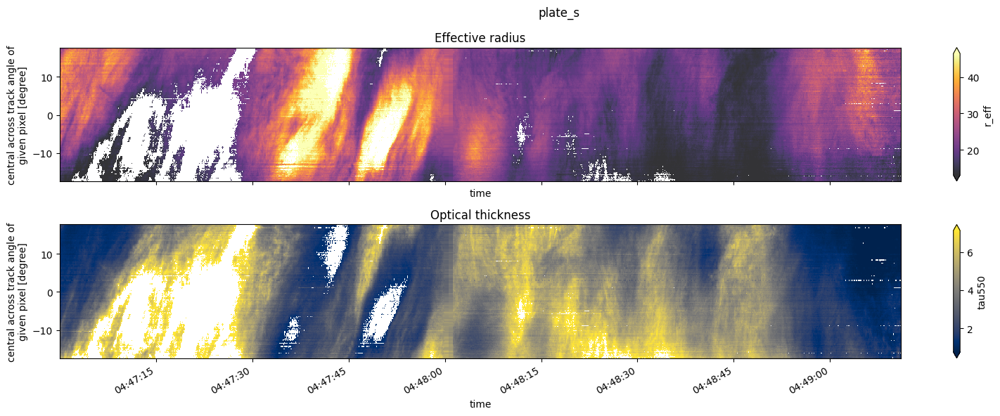

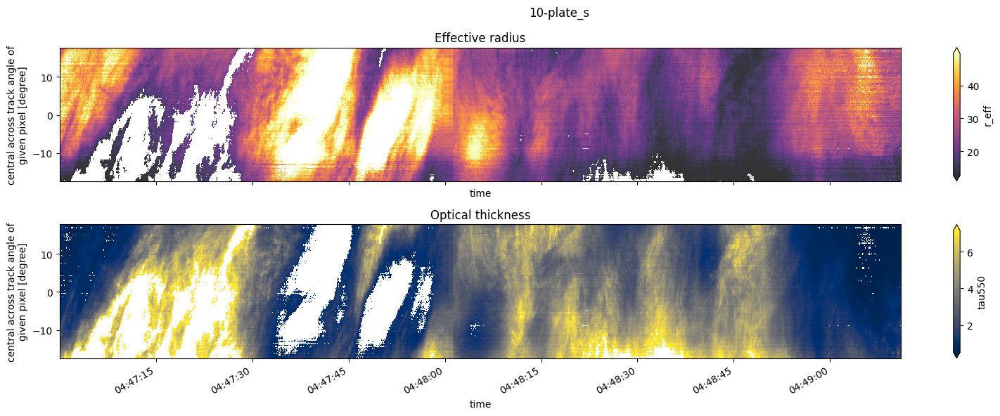

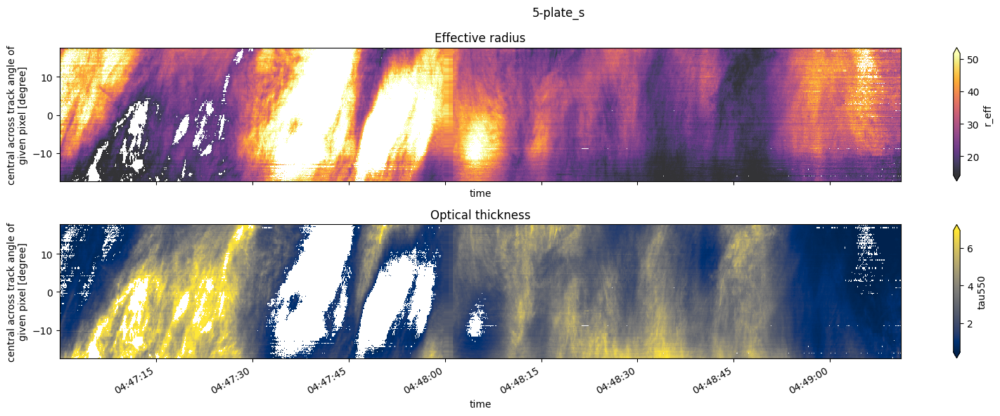

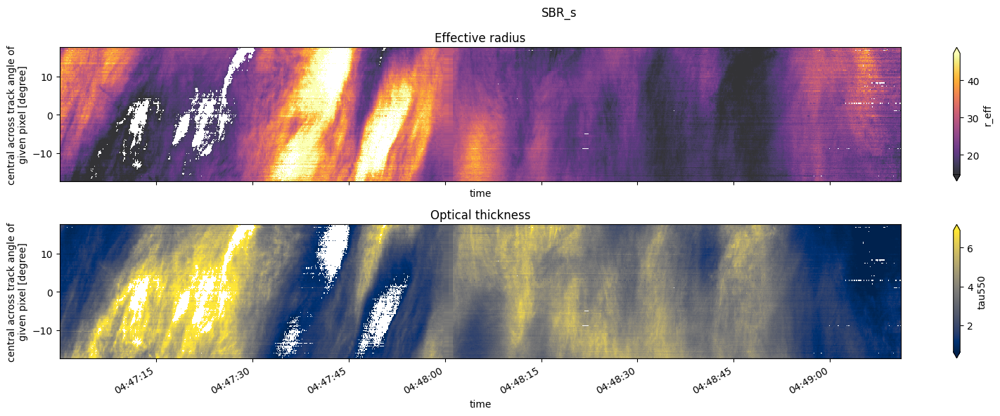

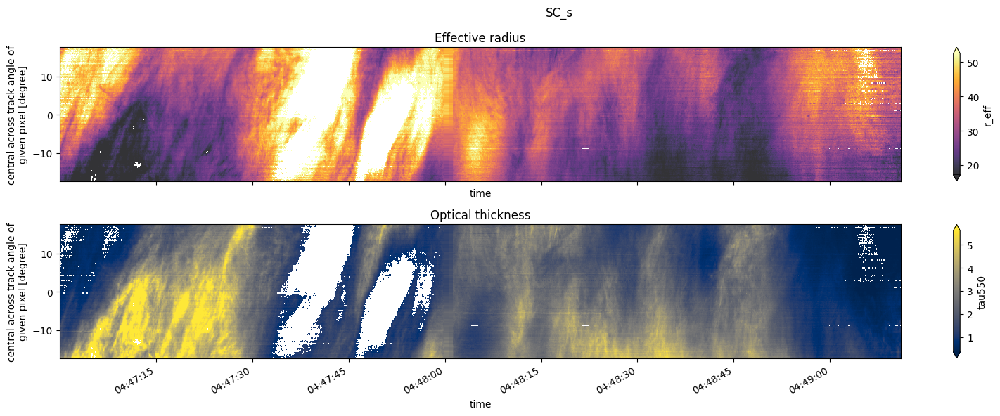

In [84]:
output = merged_cloud_properties_smooth.rolling(x=2, time=3).mean()#.coarsen(x=20, time=20, boundary='trim').mean()
for habit in output.ic_habit:

    fig, ax = plt.subplots(nrows=2, figsize=(16,6), sharex=True)
    
    output.sel(ic_habit=habit).r_eff.dropna(dim='x', how='all').plot(x='time', robust=True, ax=ax[0], cmap='inferno', alpha=0.8)
    output.sel(ic_habit=habit).tau550.dropna(dim='x', how='all').plot(x='time', robust=True, ax=ax[1], cmap='cividis')
    
    title = name_dict_smooth[habit.values.item()]
    fig.suptitle(title)
    ax[0].set_title('Effective radius')
    ax[1].set_title('Optical thickness')
    plt.tight_layout()
    plt.savefig(f"RF15_retrieval_results_{title}.png", bbox_inches='tight')

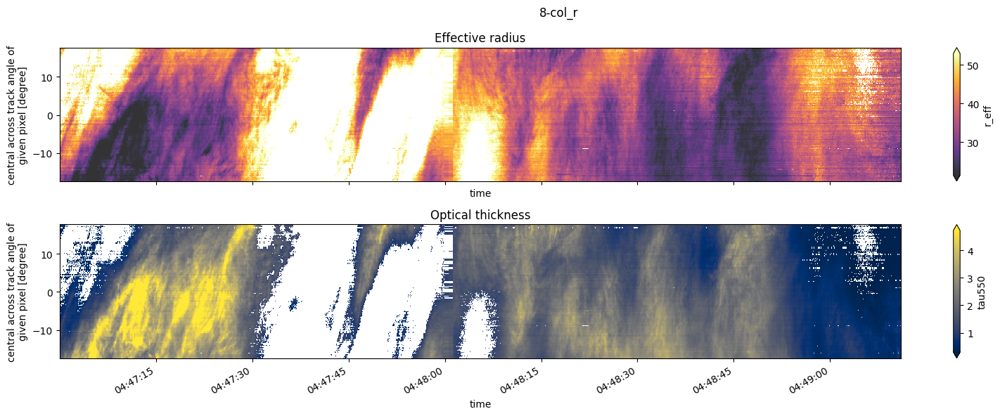

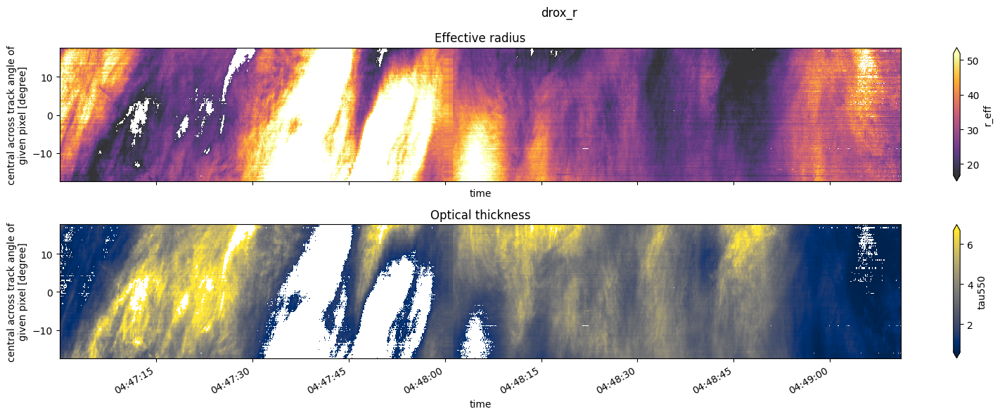

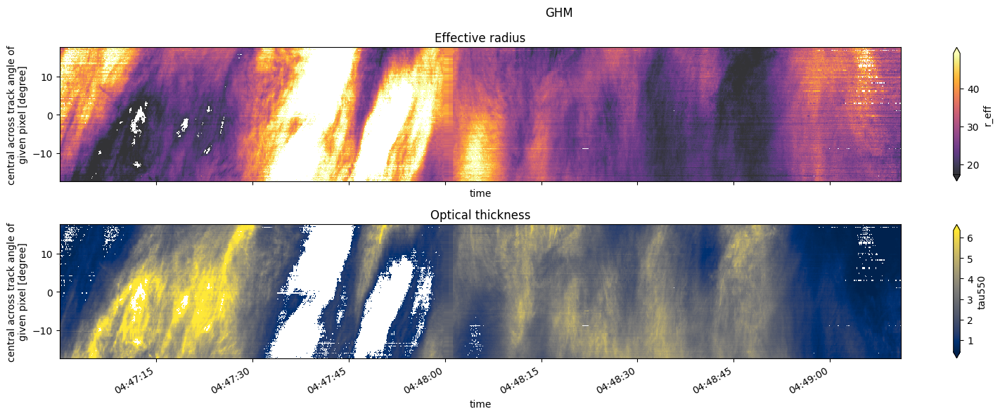

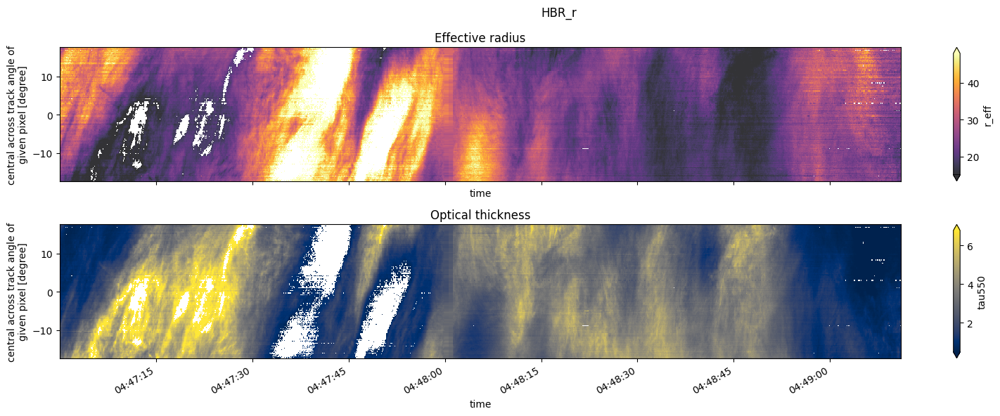

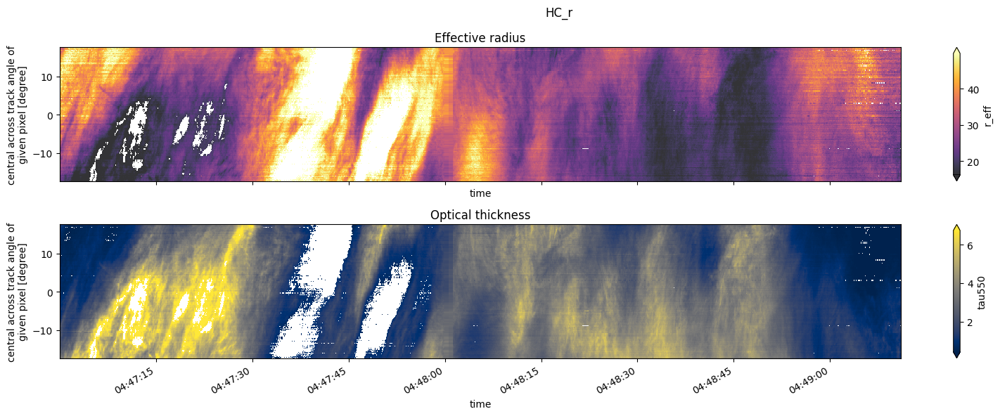

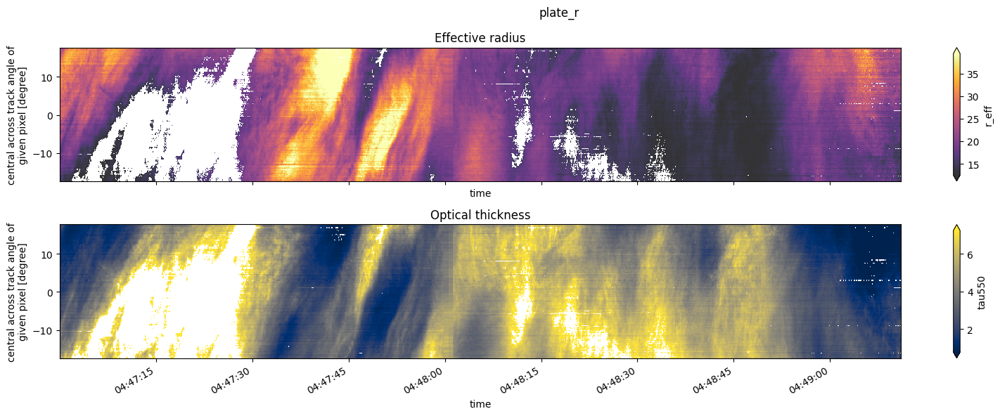

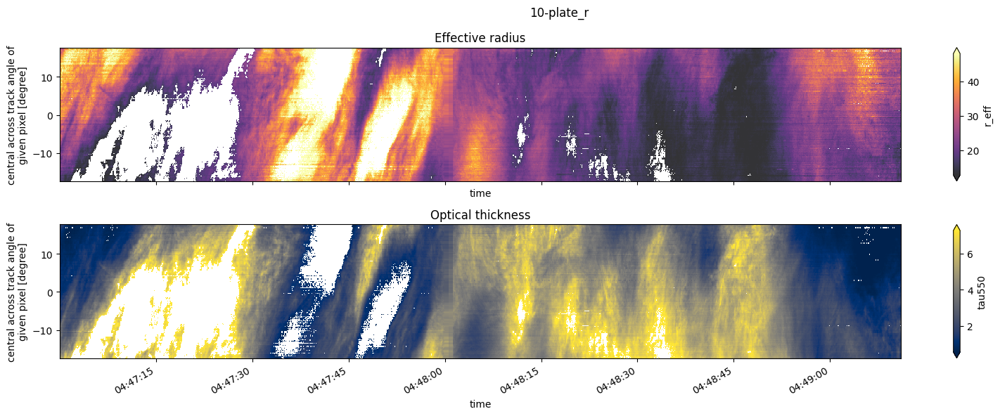

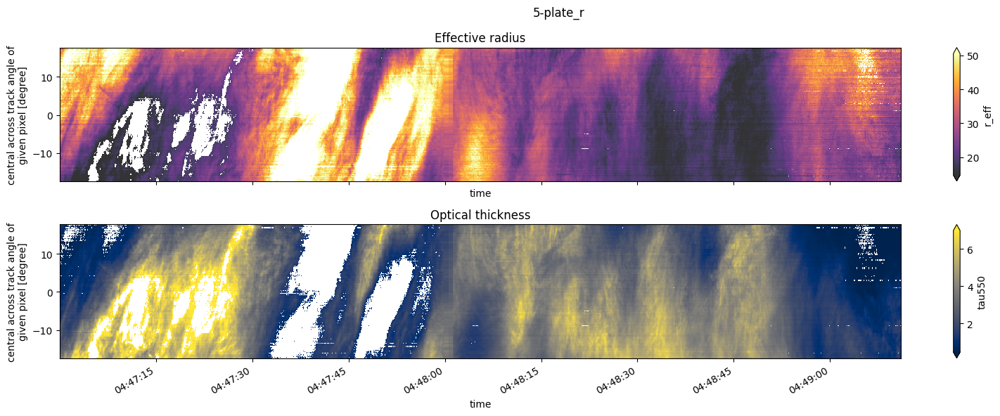

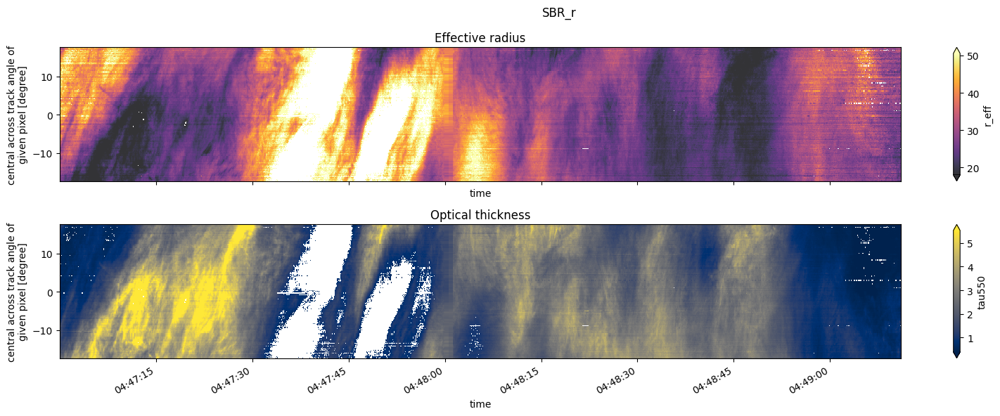

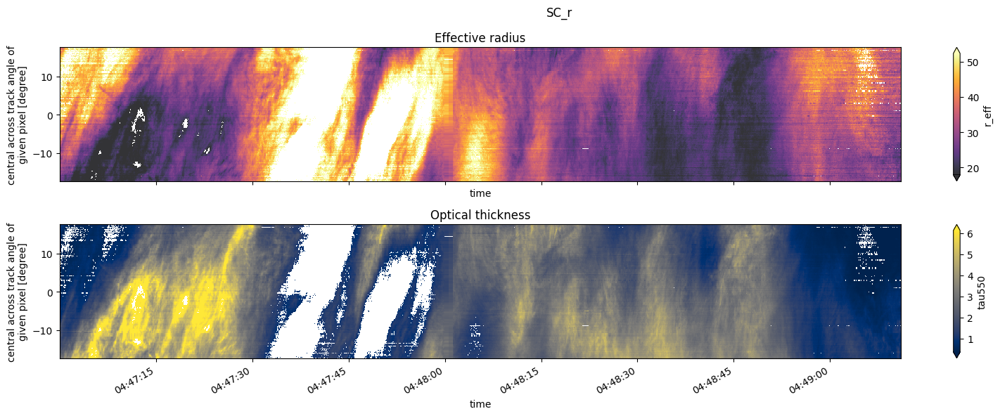

In [83]:
output = merged_cloud_properties_rough.rolling(x=2, time=3).mean()#.coarsen(x=20, time=20, boundary='trim').mean()
for habit in output.ic_habit:

    fig, ax = plt.subplots(nrows=2, figsize=(16,6), sharex=True)
    
    output.sel(ic_habit=habit).r_eff.dropna(dim='x', how='all').plot(x='time', robust=True, ax=ax[0], cmap='inferno', alpha=0.8)
    output.sel(ic_habit=habit).tau550.dropna(dim='x', how='all').plot(x='time', robust=True, ax=ax[1], cmap='cividis')
    
    title = name_dict_rough[habit.values.item()]
    fig.suptitle(title)
    ax[0].set_title('Effective radius')
    ax[1].set_title('Optical thickness')
    plt.tight_layout()
    plt.savefig(f"RF15_retrieval_results_{title}.png", bbox_inches='tight')

## Habit retrieval

In [16]:
pol = iceMACS.read_LUT('/scratch/v/Veronika.Poertge/ac3/cloudbow_retrieval_results_0_height_offset/concatenated_dennys_1_polb_with_latlonheight_with_viewing_angle.nc')
pol = pol.sel(color=0)
inflight_B = iceMACS.read_LUT('../../mystic_tests/calibration_files/specMACS_POLB_cal_CHB2021+inflight.nc')
swir_coords = iceMACS.read_LUT('/project/meteo/work/Weber.Ann/PhD/swir_phase/coords3D/swir_3D_coords_latlonheight_from_polcam_samples_2022-04-08T04:46:01_2022-04-08T04:48:59.nc')

cloud_properties_rough = iceMACS.read_LUT('data/RF15_merged_cloud_properties_rough.nc').rolling(x=2, time=20).mean().interp(time=swir_scene.time)
cloud_properties_smooth = iceMACS.read_LUT('data/RF15_merged_cloud_properties_smooth.nc').rolling(x=2, time=20).mean().interp(time=swir_scene.time)

In [17]:
pol_ds = pol.sel(sample=pol.sample[::10])

# Allocate SWIR pixels and repsective cloud properties
from iceMACS.tools import PolSceneInterpreter
pol_scene = PolSceneInterpreter(pol_ds, nas_scene, solar_positions)

In [18]:
swir_time, swir_x = pol_scene.allocated_swir_coordinates(swir_coords)

r_eff_smooth, tau550_smooth = pol_scene.allocated_cloud_properties(cloud_properties_smooth, swir_coords)
r_eff_rough, tau550_rough = pol_scene.allocated_cloud_properties(cloud_properties_rough, swir_coords)

umu, phi = pol_scene.relative_view_angles()
vza, vaa = pol_scene.absolute_view_angles()

Number of iterations:  8049


8049it [04:05, 32.81it/s]
/project/meteo/work/Dennys.Erdtmann/Thesis/iceMACS/tools.py:605: UserWarning: Dimensions of swir coordinates and cloud properties do
                            not match! This will cause false assignment of 
                            SWIR data since locations are assigned by index, not value.
                            Coordinates will now be mapped onto cloud property grid.
  warnings.warn(r"""Dimensions of swir coordinates and cloud properties do
8049it [02:33, 52.56it/s]
/project/meteo/work/Dennys.Erdtmann/Thesis/iceMACS/tools.py:605: UserWarning: Dimensions of swir coordinates and cloud properties do
                            not match! This will cause false assignment of 
                            SWIR data since locations are assigned by index, not value.
                            Coordinates will now be mapped onto cloud property grid.
  warnings.warn(r"""Dimensions of swir coordinates and cloud properties do
8049it [02:33, 52.59it/s]


In [39]:
ref = pol_scene.polarized_reflectivity(inflight_B).sel(color='red')

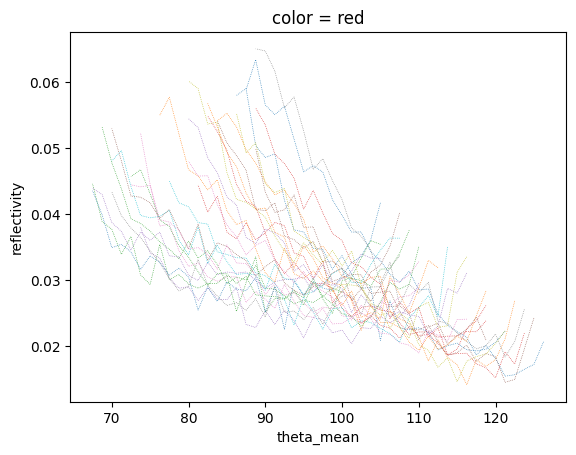

In [44]:
for sample in ref.sample[::300]:
    ref.sel(sample=sample).plot(linestyle='dotted', linewidth=0.5)

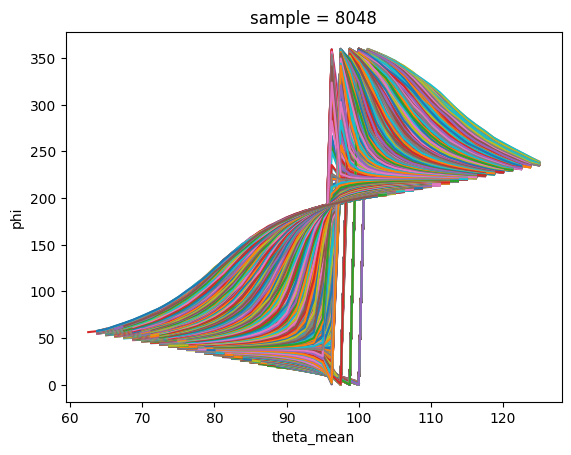

In [31]:
for sample in phi.sample:
    phi.sel(sample=sample).plot()

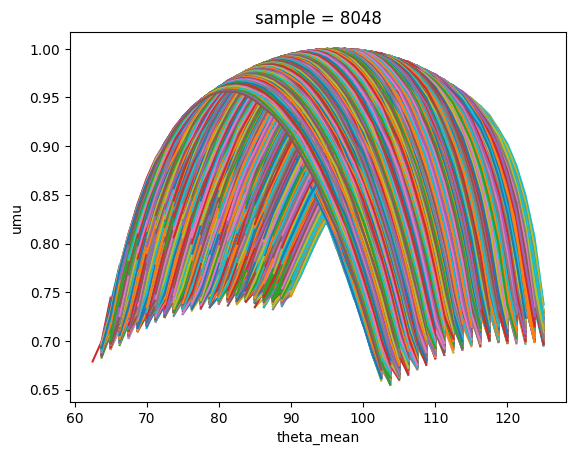

In [30]:
for sample in umu.sample:
    umu.sel(sample=sample).plot()

In [23]:
iceMACS.save_as_netcdf(xr.merge([swir_time, swir_x]), "data/swir_sample_coordinates.nc")
iceMACS.save_as_netcdf(r_eff_smooth, "data/r_eff_formatted_smooth.nc")
iceMACS.save_as_netcdf(tau550_smooth, "data/tau550_formatted_smooth.nc")
iceMACS.save_as_netcdf(r_eff_rough, "data/r_eff_formatted_rough.nc")
iceMACS.save_as_netcdf(tau550_smooth, "data/tau550_formatted_rough.nc")

In [21]:
# Read MYSTIC simulations and compute reflectivity
polLUT = iceMACS.read_LUT('LUTs/mystic/RF15_pol_LUT_yang_smooth.nc')

from iceMACS.tools import PolLookupTable
polLUT_interp=PolLookupTable(polLUT)

#sim = xr.merge([polLUT_interp.calibrated_polarized_reflectivity(inflight_B),
 #               polLUT])
    
sim = polLUT_interp.calibrated_polarized_reflectivity(inflight_B)

#refine resolution in cloud properties
r_eff_hd = np.linspace(sim.r_eff.min(), sim.r_eff.max(), num=50)
tau_hd = np.linspace(sim.tau550.min(), sim.tau550.max(), num=100)
sim_hd = sim.rolling(tau550=2).mean().interp(r_eff=r_eff_hd, tau550=tau_hd)

# choose simulated habits
r_eff_sel = r_eff_smooth.sel(ic_habit = sim_hd.ic_habit)
tau550_sel = tau550_smooth.sel(ic_habit = sim_hd.ic_habit)

# project LUT on measured dataset
sim_formatted = (sim_hd
                 .sel(r_eff=r_eff_sel, method='nearest').sel(tau550=tau550_sel, method='nearest')
                 .sel(sza=pol_scene.solar_positions.sza.mean(), method='nearest'))

sim_formatted_smooth = sim_formatted.interp(umu=umu, phi=phi)
                 
#sim_formatted = sim_formatted.where(sim_formatted.r_eff!=60)#.where(tau550_sel.tau550 != np.nan)

In [22]:
# Read MYSTIC simulations and compute reflectivity
polLUT = iceMACS.read_LUT('LUTs/mystic/RF15_pol_LUT_yang_rough.nc')

from iceMACS.tools import PolLookupTable
polLUT_interp=PolLookupTable(polLUT)

#sim = xr.merge([polLUT_interp.calibrated_polarized_reflectivity(inflight_B),
 #               polLUT])
    
sim = polLUT_interp.calibrated_polarized_reflectivity(inflight_B)

#refine resolution in cloud properties
r_eff_hd = np.linspace(sim.r_eff.min(), sim.r_eff.max(), num=50)
tau_hd = np.linspace(sim.tau550.min(), sim.tau550.max(), num=100)
sim_hd = sim.rolling(tau550=2).mean().interp(r_eff=r_eff_hd, tau550=tau_hd)

# choose simulated habits
r_eff_sel = r_eff_rough.sel(ic_habit = sim_hd.ic_habit)
tau550_sel = tau550_rough.sel(ic_habit = sim_hd.ic_habit)

# project LUT on measured dataset
sim_formatted = (sim_hd
                 .sel(r_eff=r_eff_sel, tau550=tau550_sel, method='nearest')
                 .sel(sza=pol_scene.solar_positions.sza.mean(), method='nearest'))

sim_formatted_rough = sim_formatted.interp(umu=umu, phi=phi)
                 
#sim_formatted = sim_formatted.where(sim_formatted.r_eff!=60)#.where(tau550_sel.tau550 != np.nan)

In [24]:
iceMACS.save_as_netcdf(sim_formatted_rough, "data/sim_formatted_rough.nc")
iceMACS.save_as_netcdf(sim_formatted_smooth, "data/sim_formatted_smooth.nc")

In [ ]:
absolute_signal_rough = sim_formatted_rough
relative_signal_rough = absolute_signal_rough/absolute_signal_rough.mean(dim='theta_mean')

absolute_signal_smooth = sim_formatted_smooth
relative_signal_smooth = absolute_signal_smooth/absolute_signal_smooth.mean(dim='theta_mean')

absolute_measured_reflectivity = pol_scene.polarized_reflectivity(inflight_B).sel(color='red', sample=pol_ds.sample)
relative_measured_reflectivity = absolute_measured_reflectivity/absolute_measured_reflectivity.mean(dim="theta_mean")